<a href="https://colab.research.google.com/github/teerasitk/thaicomRemoteSensing/blob/main/Workshop_on_Image_Transformation_and_Indices.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Image Transformation and Indices**

The goal of this assignment is to allow students to get familiar with indices and image transformations. The main objective is to understand what they are and how to you them properly. In some indices, students try to implement themself.


The following parts are step-by-step in how to implement some indices and transformations, and show them.

1. Intialize Google Earth Engine and import libraries

In [ ]:
import ee
ee.Authenticate()
ee.Initialize()
import numpy as np
import folium
import matplotlib.pyplot as plt 

To authorize access needed by Earth Engine, open the following URL in a web browser and follow the instructions. If the web browser does not start automatically, please manually browse the URL below.

    https://accounts.google.com/o/oauth2/auth?client_id=517222506229-vsmmajv00ul0bs7p89v5m89qs8eb9359.apps.googleusercontent.com&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fearthengine+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdevstorage.full_control&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&response_type=code&code_challenge=lUAKn9_5Ebod_MNm4oPeDuymsYF83FqeuOo6c9mD3Pk&code_challenge_method=S256

The authorization workflow will generate a code, which you should paste in the box below. 
Enter verification code: 4/1AX4XfWgX6Cej9hadQ-NuKSCJGwrNf_51B6lsoc94PFAvqvQIn1RcT4kUAGA

Successfully saved authorization token.


2. For the ease of display images using folium, I have written two codes for display indices (1-Band Data), and images (3-Bands) data. 

In [ ]:
def showIndex(image:ee.Image, # index image to display
              index_name: str, # index band and
              aoi:ee.Geometry, # area to display
              min_v:float=-0.5, # minimum value of index
              max_v:float=1,  # maximum value of index
              zoom:int=15 # Google Map zoom factor 1-18
              )->folium.Map:
  """
  This code produces folium map object to be displayed from the given index. 
  Only one index can be displayed.
  """
  xc, yc =  aoi.centroid().getInfo()['coordinates'] # get AOI centroid
  aoi_map = folium.Map(location=[yc, xc], zoom_start=zoom) # initialize forlium map objkect
  basemaps = {'Google Maps': folium.TileLayer(
    tiles = 'https://mt1.google.com/vt/lyrs=m&x={x}&y={y}&z={z}',  #Change =m to =s if you want to overlay on Google Satellite
    attr = 'Google',  
    name = 'Google Maps', 
    overlay = True,
    control=True)} # tell folium that the base map is the google map. 
  basemaps['Google Maps'].add_to(aoi_map) # add google earth data into ku_map
  im_clib = image.clip(aoi) # clip image to display only AOI
  viz_params = {'bands':[index_name], # band to display
                'min': min_v, 'max':max_v,
                'palette': ['000000', # color to diplay from min_v black
                            'A50026', 
                            'D73027',
                            'F46D43', 
                            'FDAE61',
                            'FEE08B',
                            'FFFFBF', 
                            'D9EF8B', 
                            'A6D96A',
                            '66BD63', 
                            '1A9850', 
                            '006837']# green for max_v
                } 
  map_obj = im_clib.getMapId(viz_params) # convert image into map object

  folium.TileLayer(
      tiles=map_obj ['tile_fetcher'].url_format, #item where the image is linked to
      overlay=True,
      attr='Index Image',
      name=index_name,
    ).add_to(aoi_map)
  return aoi_map

def showImageOnMap(image:ee.Image, # Image to show
                   bands:list, #band to display in [RED, GREEN, BLUE]
                   aoi:ee.Geometry, # area of interst 
                   min_val:float=0, # minimum value
                   max_val:float=1, # maximum value
                   zoom=15 # google map zoom scale
                   )->folium.Map:
  """
  This code produces folium map object to be displayed from a given image. 
  
  """
  xc, yc =  aoi.centroid().getInfo()['coordinates'] # get AOI centroid
  aoi_map = folium.Map(location=[yc, xc], zoom_start=zoom) # initialize forlium map objkect
  basemaps = {'Google Maps': folium.TileLayer(
    tiles = 'https://mt1.google.com/vt/lyrs=m&x={x}&y={y}&z={z}',  #Change =m to =s if you want to overlay on Google Satellite
    attr = 'Google',  
    name = 'Google Maps', 
    overlay = True,
    control=True)} # tell folium that the base map is the google map. 
  basemaps['Google Maps'].add_to(aoi_map) # add google earth data into ku_map
  im_clib = image.clip(aoi) # clip to AOI
  viz_params = {'bands':bands, 'min': min_val, 
                'max': max_val} 
  map_obj = im_clib.getMapId(viz_params) # convert image into map object

  folium.TileLayer(
      tiles=map_obj ['tile_fetcher'].url_format, #item where the image is linked to
      overlay=True,
      attr='Image',
      name=f'Diplay Image',
    ).add_to(aoi_map)
  return aoi_map

def getNewBandNames(prefix:str, 
                    num:int)->list:
  """
  This function make a list of band names with a given prefix. It will be used in PCA.
  """
  return [f"{prefix}{k}" for k in range(num)]
def normalizeAllBand(image:ee.Image, # image to be normalized
                     aoi:ee.Geometry # area of interst
                     )->ee.Image:
  """
  Each band of image are normalized to have the value between 0 and 1 where
  the values below the 2nd precentile are assigned to zero and the value higher 
  than the 98th precentile are assigned to one. Another values are stretched to
  0 and 1.
  """
  img_band_names = image.bandNames().getInfo() # get all band names
  imout = None  # start with None Image
  for band in img_band_names:
    imb = image.select(band) # for specific band
    min_max = imb.reduceRegion(ee.Reducer.percentile([2,98]),
                              geometry=aoi, scale=10) # obtain 2nd and 98 percentiles
  
    imb = imb.unitScale(min_max.get(band+'_p2'), min_max.get(band+'_p98'))
    # strech to 0 and 1
    if imout is None:
      imout = imb
    else:
      imout = imout.addBands(imb)
  return imout

# PART 1: Getting used to the indices

Example code on how to use showImageOnMap

3. Make ee.Image from a given AOI

In [ ]:
aoi = ee.Geometry.Polygon([ [ 100.541493355798877, 13.667854190169896 ], 
                           [ 100.54097354874834, 13.670758155189185 ], 
                           [ 100.544301729449543, 13.671799019171798 ], 
                           [ 100.547750495003157, 13.675074738731468 ], 
                           [ 100.549610503391662, 13.678425715038724 ], 
                           [ 100.550827326727102, 13.680968394137279 ], 
                           [ 100.551069515319369, 13.686615938057528 ], 
                           [ 100.550282402394558, 13.691204467678372 ], 
                           [ 100.549374195173613, 13.695557605338106 ],
                           [ 100.549555836617799, 13.699322416157742 ], 
                           [ 100.55034294954261, 13.703322461581749 ],
                           [ 100.553309759797656, 13.706557742630304 ], 
                           [ 100.558637908827137, 13.708322422605224 ], 
                           [ 100.566085208038814, 13.707204793493704 ],
                           [ 100.577649713318721, 13.703381285271167 ], 
                           [ 100.584491541049758, 13.699145941997498 ], 
                           [ 100.590182972967597, 13.692145693459826 ],
                           [ 100.591393915928862, 13.684439296557217 ], 
                           [ 100.589485238039885, 13.679493377964228 ], 
                           [ 100.582074267117065, 13.669092064877388 ], 
                           [ 100.574090877898371, 13.660869335651094 ], 
                           [ 100.564778000433648, 13.654992971576068 ],
                           [ 100.555893645335416, 13.653882173381541 ], 
                           [ 100.548841113529107, 13.656103812227759 ], 
                           [ 100.543338588713212, 13.658438393208138 ], 
                           [ 100.541493355798877, 13.667854190169896 ] ])


Use sentinel 2 surface reflectance ("COPERNICUS/S2_SR") to download an image captured on 2021-02-05 and display with RED:B8, Green: B4, BLUE:B3

In [ ]:
sen2 = ee.ImageCollection("COPERNICUS/S2_SR") 
sen2 = sen2.filterBounds(aoi)
sen2 = sen2.filterDate("2021-02-05", "2021-02-06")
print(f"There are {sen2.size().getInfo()} image(s) in the collection")
sen2_list = sen2.toList(1)
im_sen2 = ee.Image(sen2_list.get(0))
im_sen2 = im_sen2.multiply(0.0001)
showim_map = showImageOnMap(im_sen2, ["B8", "B4", "B3"], aoi, min_val=0, max_val=0.75, zoom=14)
display(showim_map)

There are 1 image(s) in the collection


## Question 1: 
What is the location of this image?




###Answer 1 :______.

#Normalized Difference Vegetation Index (NDVI)
The fomular for NDVI is given as 

$NDVI = \frac{\rho_{NIR}- \rho_{RED}}{\rho_{NIR} + \rho_{RED}}$

The code below is how to compute NDVI for LANDSAT 8-9 and Sentinel 2

In [ ]:
def compNDVI(image, sat="LANDSAT"):
  if sat.upper() == "LANDSAT":
    nir = image.select("SR_B5")
    red = image.select("SR_B4") 
    L = ee.Number(0.5)
  elif sat.upper() == "SENTINEL2":
    nir = image.select("B8")
    red = image.select("B4")
    L = ee.Number(0.48)
  num = nir.subtract(red)
  den = nir.add(red)
  ndvi = num.divide(den)
  ndvi = ndvi.rename("ndvi")
  return ndvi

Let us display the NDVI on Google map


Diplay the NDVI on the "aoi" using Sentinel 2 in Question 1 with min_v=0 and max_v=0.75

In [ ]:
# Your code here.
ndvi = compNDVI(im_sen2, sat="sentinel2")
print(ndvi.reduceRegion(ee.Reducer.minMax(), geometry=aoi).getInfo())
show_map = showIndex(ndvi,"ndvi",aoi, zoom=14, min_v=0, max_v=0.75)
show_map

{'ndvi_max': 0.8419512195121951, 'ndvi_min': -0.5492154065620543}


# Soil-adjusted Vegetation Index (SAVI)

From your lecture, the SAVI is defined as

 $SAVI=(1+L)\frac{\rho_{NIR}- \rho_{RED}}{\rho_{NIR} + \rho_{RED}+L}$ 

where $L=0.5$ for LANDSATs 8-9 and $L=0.48$ for Sentinel 2.

## Question 2:

By using the example from NDVI, write your own code to compute the SAVI for sentinel 2. Please note that in Google Earth Engine if you want to compute $y=5x$ where $x$ is an ee.Image, you must write

y = x.multiple(5)

Also, diplay the SAVI on the same AOI of Sentinel 2 in Question 1 with min_v=0 and max_v=0.75

In [ ]:
# Your code here


# Leaf Area Index (LAI)

LAI is a dimensionless index measuring the one-sided green leaf over a unit of loand ($m^2/m^2$).

I have implemented the Google Earth Engine version based on the code given from [LAI Custom-script](https://custom-scripts.sentinel-hub.com/sentinel-2/lai/). Please note that my version assumes that the view Azimuth, view Zeneith, Solar Azimuth and Solar Zeneith angles to be constant over the entire scene where the SNAP version uses the auxilary date in the orginal Sentinel2 to compute these angles at 5 km $\times$ 5 km resolution.


In [ ]:
import numpy as np
def normalize(data, min_val, max_val):
  out = data.subtract(min_val).multiply(2.0/(max_val-min_val))
  out = out.subtract(1)
  return out
def denormalize(data, min_val, max_val):
  out = data.add(1).multiply(0.5*(max_val-min_val))
  out = out.add(min_val)
  return out
def tansig(data):
  out = data.multiply(-2)
  out = out.exp().add(1)
  out = out.pow(-1)
  out = out.multiply(2).subtract(1)
  return out
def neuron1(b03, b04, b05, b06, b07, b08a, b11, b12, view_zen, sun_zen, relAzim):
  out = b03.multiply(-0.023406878966470)
  out = out.add(b04.multiply(0.921655164636366))
  out = out.add(b05.multiply(0.135576544080099))
  out = out.add(b06.multiply(-1.938331472397950))
  out = out.add(b07.multiply(-3.342495816122680))
  out = out.add(b08a.multiply(0.902277648009576))
  out = out.add(b11.multiply(0.205363538258614))
  out = out.add(b12.multiply(-0.040607844721716))
  out = out.add(view_zen.multiply(-0.083196409727092))
  out = out.add(sun_zen.multiply(0.260029270773809))
  out = out.add(relAzim.multiply(0.284761567218845))
  out = out.add(4.96238030555279)
  out = tansig(out)
  return out 
def neuron2(b03, b04, b05, b06, b07, b08a, b11, b12, view_zen, sun_zen, relAzim):
  out = b03.multiply(-0.132555480856684)
  out = out.add(b04.multiply(-0.139574837333540))
  out = out.add(b05.multiply(-1.0146060168989209))
  out = out.add(b06.multiply(-1.3308900386492700))
  out = out.add(b07.multiply(0.031730624503341))
  out = out.add(b08a.multiply(-1.433583541317050))
  out = out.add(b11.multiply(-0.959637898574699))
  out = out.add(b12.multiply(1.133115706551000))
  out = out.add(view_zen.multiply(0.216603876541632))
  out = out.add(sun_zen.multiply(0.410652303762839))
  out = out.add(relAzim.multiply(0.064760155543506))
  out = out.add(1.416008443981500)
  out = tansig(out)
  return out 
def neuron3(b03, b04, b05, b06, b07, b08a, b11, b12, view_zen, sun_zen, relAzim):
  out = b03.multiply(0.086015977724868)
  out = out.add(b04.multiply(0.616648776881434))
  out = out.add(b05.multiply(0.678003876446556))
  out = out.add(b06.multiply(0.141102398644968))
  out = out.add(b07.multiply(-0.096682206883546))
  out = out.add(b08a.multiply(-1.128832638862200))
  out = out.add(b11.multiply(0.302189102741375))
  out = out.add(b12.multiply(0.434494937299725))
  out = out.add(view_zen.multiply(-0.021903699490589))
  out = out.add(sun_zen.multiply(-0.228492476802263))
  out = out.add(relAzim.multiply(-0.039460537589826))
  out = out.add(1.075897047213310)
  out = tansig(out)
  return out 
def neuron4(b03, b04, b05, b06, b07, b08a, b11, b12, view_zen, sun_zen, relAzim):
  out = b03.multiply(-0.109366593670404)
  out = out.add(b04.multiply(-0.071046262972729))
  out = out.add(b05.multiply(0.064582411478320))
  out = out.add(b06.multiply(2.906325236823160))
  out = out.add(b07.multiply(-0.67387310897916))
  out = out.add(b08a.multiply(-3.838051868280840))
  out = out.add(b11.multiply(1.69597934453153))
  out = out.add(b12.multiply(0.046950296081713))
  out = out.add(view_zen.multiply(-0.049709652688365))
  out = out.add(sun_zen.multiply(0.021829545430994))
  out = out.add(relAzim.multiply(0.057483827104091))
  out = out.add(1.533988264655420)
  out = tansig(out)
  return out 
def neuron5(b03, b04, b05, b06, b07, b08a, b11, b12, view_zen, sun_zen, relAzim):
  out = b03.multiply(-0.089939416159969)
  out = out.add(b04.multiply(0.175395483106147))
  out = out.add(b05.multiply(-0.081847329172620))
  out = out.add(b06.multiply(2.219895367487790))
  out = out.add(b07.multiply(1.713873975136850))
  out = out.add(b08a.multiply(0.713069186099534))
  out = out.add(b11.multiply(0.138970813499201))
  out = out.add(b12.multiply(-0.060771761518025))
  out = out.add(view_zen.multiply(0.124263341255473))
  out = out.add(sun_zen.multiply(0.210086140404351))
  out = out.add(relAzim.multiply(-0.183878138700341))
  out = out.add(3.024115930757230)
  out = tansig(out)
  return out 
def layer2(n1, n2, n3, n4, n5):
  out = n1.multiply(-1.500135489728730)
  out = out.add(n2.multiply(-0.09628326912150))
  out = out.add(n3.multiply(-0.194935930577094))
  out = out.add(n4.multiply(-0.352305895755591))
  out = out.add(n5.multiply(0.075107415847473))
  out = out.add(1.096963107077220)
  return out
def compLAI(image):
  bands = ["B3", "B4", "B5", "B6", "B7", "B8A", "B11", "B12"]
  degToRad = np.pi/180.
  viewAzimuth = ee.Number(0)
  viewZeneith = ee.Number(0)
  for band in bands:
    viewAzimuth = viewAzimuth.add(ee.Number(image.get(f"MEAN_INCIDENCE_AZIMUTH_ANGLE_{band}")))
    viewZeneith = viewZeneith.add(ee.Number(image.get(f"MEAN_INCIDENCE_ZENITH_ANGLE_{band}")))
  viewAzimuth = viewAzimuth.divide(len(bands)).multiply(degToRad)
  viewZeneith = viewZeneith.divide(len(bands)).multiply(degToRad)
  solarAzimuth = ee.Number(image.get(f"MEAN_SOLAR_AZIMUTH_ANGLE")).multiply(degToRad)
  solarZeneith = ee.Number(image.get(f"MEAN_SOLAR_ZENITH_ANGLE")).multiply(degToRad)
  viewZen = normalize(viewZeneith.cos(), 0.918595400582046, 1)
  sunZen = normalize(solarZeneith.cos(), 0.342022871159208, 0.936206429175402)  
  relAzim = solarAzimuth.subtract(viewAzimuth).cos()
  
  
  image = image.multiply(0.0001)
  b03 = normalize(image.select("B3"), 0, 0.253061520471542)
  b04 = normalize(image.select("B4"), 0, 0.290393577911328)
  b05 = normalize(image.select("B5"), 0, 0.305398915248555)
  b06 = normalize(image.select("B6"), 0.006637972542253, 0.608900395797889)
  b07 = normalize(image.select("B7"), 0.013972727018939, 0.753827384322927)
  b08a = normalize(image.select("B8A"), 0.026690138082061, 0.782011770669178)
  b11 = normalize(image.select("B11"), 0.016388074192258, 0.493761397883092)
  b12 = normalize(image.select("B12"), 0, 0.493025984460231)
  
  n1 = neuron1(b03,b04,b05,b06,b07,b08a,b11,b12, viewZen,sunZen,relAzim)
  n2 = neuron2(b03,b04,b05,b06,b07,b08a,b11,b12, viewZen,sunZen,relAzim)
  n3 = neuron3(b03,b04,b05,b06,b07,b08a,b11,b12, viewZen,sunZen,relAzim)
  n4 = neuron4(b03,b04,b05,b06,b07,b08a,b11,b12, viewZen,sunZen,relAzim)
  n5 = neuron5(b03,b04,b05,b06,b07,b08a,b11,b12, viewZen,sunZen,relAzim)
  l2 = layer2(n1, n2, n3, n4, n5)
  lai = denormalize(l2, 0.000319182538301, 14.4675094548151)
  lai2 = lai.divide(3)#.rename("lai")
  #lai2 = lai.gt(2).float()
  return lai2.rename("lai")

## Question 3:

Use the function *compLAI* to compute the LAI. Also, diplay the LAI on the same AOI of Sentinel 2 in Question 1 with min_v=0 and max_v=0.75

In [ ]:
# Your code here


##Question 4: 
In your opinion, between NDVI, SAVI, and LAI which one can discriminate between vegtation and non-vegtation better?

### Answer 4:_______________.

# Part II: Indices for time-series analysis

Upload the following files into your Colab Files:
- indicesShapes.cpg
- indicesShapes.dbf
- indicesShapes.prj
- indicesShapes.shp
- indicesShapes.shx

In this shape file, there are **six** shapes covering
- Polygon1: Rubber Plantation
- Polygon2: Forest 
- Polygon3: Rice Farm
- Polygon4: Rice Farm
- Polygon5: Forest
- Polygon6: Rice Farm

We will use geopandas to read these polygons by clicking run on the code below

In [ ]:
!pip install geopandas
import geopandas as gpd 
import pandas as pd
import json
from datetime import datetime  # for print datetime
df = gpd.read_file("/content/indicesShapes.shp")

We will use data from 2021-03-01 to 2022-03-01 to make the time-series data of entire year and observe the differences

In [ ]:
# data frame of polygons
df

,id,Type,typeID,geometry
0,1,Rubber,1,"POLYGON ((103.30920 18.21759, 103.30993 18.217..."
1,2,Forest,2,"POLYGON ((101.06865 16.93248, 101.07248 16.933..."
2,3,Rice Farms,3,"POLYGON ((104.07384 15.88589, 104.07614 15.881..."
3,4,Rice Farms,3,"POLYGON ((100.65978 14.21437, 100.65842 14.214..."
4,5,Forest,2,"POLYGON ((100.93571 16.99295, 100.93675 16.993..."
5,6,Rice,3,"POLYGON ((100.82480 14.00717, 100.82480 14.007..."


The code below is used to plot the time-series NDVI and RVI4S1 of all the polygons

In [ ]:
# time series data
date0 = ee.Date("2021-03-01")
date1 = ee.Date("2022-03-01")
ndvi_list = []
savi_list = []
lai_list = []
for fid in df.id: # for each field
  sen2 = ee.ImageCollection("COPERNICUS/S2_SR") # Sentinel 2 surface reflectance
  sen2 = sen2.filterDate(date0, date1) # filter date
  a_row = df[df.id==fid].to_json() # obtain a row of data frame
  a_row_json =json.loads(a_row) # 
  aoi = ee.Geometry(a_row_json["features"][0]["geometry"]) # get the ploygon
  sen2 = sen2.filterBounds(aoi) # filter polygon ara
  num_images = sen2.size().getInfo() # check how many images
  print(f"There are {num_images} images in the polygon") 
  sen2 = sen2.sort("system:time_start") # sort based on time
  sen2_list = sen2.toList(num_images) # change to list
  ndvis = []  # empty list of ndvi
  savis = []
  lais = []
  dates = [] # empty list of dates
  for k in range(num_images): # for each image index
    im = ee.Image(sen2_list.get(k)) # obtain image k in the collection
    date = im.getInfo()['properties']["system:time_start"] # get date properties
    date = date_time_obj = datetime.fromtimestamp(date/1000.0) # change to datetime object
    datetxt = date.strftime('%Y-%m-%d') # make into a text
    cloud_prob = im.select("MSK_CLDPRB").reduceRegion(ee.Reducer.mean(), aoi).getInfo()["MSK_CLDPRB"]
    # obtain cloud probability
    print(f"Working on {datetxt} with Cloud Prob {cloud_prob:0.1f}")    
    if cloud_prob < 10:     # we will use only image with less than 10% clouds
      ndvi = compNDVI(im, sat="sentinel2")
      ndvi = ndvi.reduceRegion(ee.Reducer.mean(), aoi).getInfo() # average of the polygon
      ndvi = ndvi["ndvi"]
      ndvis.append(ndvi)

      savi = compSAVI(im, sat="sentinel2")
      savi = savi.reduceRegion(ee.Reducer.mean(), aoi).getInfo() # average of the polygon
      savi = savi["savi"]
      savis.append(savi)      

      lai= compLAI(im)
      lai = lai.reduceRegion(ee.Reducer.mean(), aoi).getInfo() # average of the polygon
      lai = lai["lai"]
      lais.append(lai) 


      dates.append(date)

  
  ndvi_series = pd.Series(ndvis, index=dates) # make ndvi into time_series Data
  savis_series = pd.Series(savis, index=dates) # make savi into time_series Data
  lais_series = pd.Series(lais, index=dates) # make lai into time_series Data
  ndvi_list.append(ndvi_series)
  savi_list.append(savis_series)
  lai_list.append(lais_series)

There are 142 images in the polygon
Working on 2021-03-02 with Cloud Prob 4.9
Working on 2021-03-04 with Cloud Prob 98.0
Working on 2021-03-07 with Cloud Prob 0.0
Working on 2021-03-09 with Cloud Prob 0.0
Working on 2021-03-12 with Cloud Prob 1.4
Working on 2021-03-14 with Cloud Prob 0.0
Working on 2021-03-17 with Cloud Prob 4.3
Working on 2021-03-22 with Cloud Prob 0.0
Working on 2021-03-24 with Cloud Prob 0.1
Working on 2021-03-27 with Cloud Prob 4.6
Working on 2021-03-29 with Cloud Prob 0.0
Working on 2021-04-01 with Cloud Prob 1.5
Working on 2021-04-03 with Cloud Prob 39.0
Working on 2021-04-06 with Cloud Prob 27.4
Working on 2021-04-08 with Cloud Prob 0.0
Working on 2021-04-11 with Cloud Prob 0.6
Working on 2021-04-13 with Cloud Prob 0.0
Working on 2021-04-16 with Cloud Prob 0.0
Working on 2021-04-18 with Cloud Prob 100.0
Working on 2021-04-21 with Cloud Prob 12.9
Working on 2021-04-23 with Cloud Prob 0.0
Working on 2021-04-26 with Cloud Prob 94.5
Working on 2021-04-28 with Cloud 

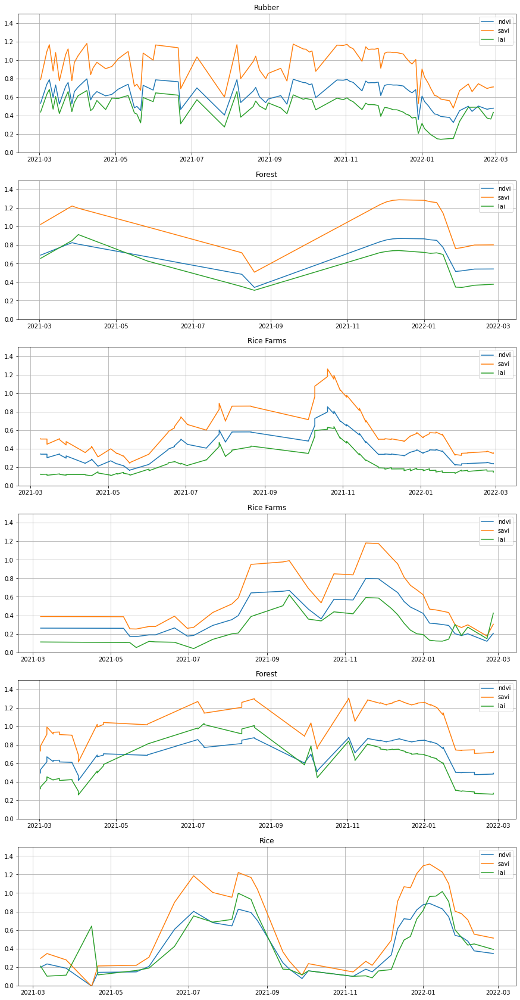

In [ ]:
plt.figure(figsize=(15,30))
cnt = 1
for ndvi, savi, lai, f_name in zip(ndvi_list, savi_list, lai_list, df.Type):
  plt.subplot(6,1,cnt)  
  plt.plot(ndvi, label="ndvi")  
  plt.plot(savi, label="savi")
  plt.plot(lai, label="lai")  
  plt.ylim(0, 1.5)
  plt.grid()
  plt.title(f_name)
  plt.legend()
  cnt += 1

In [ ]:
# code for RVI4S1
def compRVI4S1(image):
  vv = image.select("VV")
  vh = image.select("VH")
  nor = vh.multiply(4)
  den = vv.add(vh)
  rvi = nor.divide(den).rename("rvi")
  return rvi 

In this example, we will also include the vegetation index using Sentinel 1 (SAR). This index is called *Radar Vegetation Index for Sentinel-1* (RVI4S1) defined as

$RVI4S1 = \frac{4*\sigma_{VH}^0}{\sigma_{VV}^0+\sigma_{VH}^0}$

The RVI was proposed by Kim et al in 2012, and it is defined as

$RVI = \frac{8\sigma_{HV}^0}{\sigma_{HH}^0 + \sigma_{VV}^0 + 2\sigma_{HV}^0}$.

Charbonneau et al (2005) suggests that if $\sigma_{HH} ≈ \sigma_{VV}$,  the RVI can be modified to

$RVI= \frac{4*\sigma_{HV}^0}{\sigma_{HH}^0 + \sigma_{HV}^0}$.


 [1] Y. Kim, T. Jackson, R. Bindlish, H. Lee and S. Hong, "Radar Vegetation Index for Estimating the Vegetation Water Content of Rice and Soybean," in IEEE Geoscience and Remote Sensing Letters, vol. 9, no. 4, pp. 564-568, July 2012, doi: 10.1109/LGRS.2011.2174772.

 [2] Charbonneau, F.; Trudel, M.; Fernandes, R. Use of Dual Polarization and Multi-Incidence SAR for soil permeability mapping. In Proceedings of the 2005 Advanced Synthetic Aperture Radar (ASAR) Workshop, St-Hubert, QC, Canada, 15ñ17 November 2005.

## Question 5: 
Write your own code to compute the time-series RVI. 
Note that 
1. You will use **COPERNICUS/S1_GRD_FLOAT** image collection. 
2. Setinel 1 has two modes, ASCENDING and DECENDING. For a given polygon, you will use the mode that has the maximum number of images.

The code below will give you with two image collections for ascending and decending modes

In this example, we will use 

In [ ]:
sen1 = ee.ImageCollection('COPERNICUS/S1_GRD_FLOAT')
sen1 = sen1.filterDate(date0, date1)
sen1 = sen1.filter(ee.Filter.eq('instrumentMode', 'IW'));
sen1 = sen1.filterBounds(aoi)
sen1a = sen1.filter(ee.Filter.eq('orbitProperties_pass', 'ASCENDING'))
sen1d = sen1.filter(ee.Filter.eq('orbitProperties_pass', 'DESCENDING'))
num_a_images = sen1a.size().getInfo()
num_d_images = sen1d.size().getInfo()
print(f"There are {num_a_images} and {num_d_images} for ascending and descending mode")

There are 31 and 48 for ascending and descending mode


In the above case, we will use descending mode.

In [ ]:
# write your own code to generate time-series RVI


## Question  6:
Plot NDVI, SAVI, LAI and RVI on the same graphs for all polygons.

In [ ]:
# your code here


## Question 7: 
Do you think that RVI can beuse to monitor vegetation growth?

### Answer 7:___________________________.

# Part III: Image Transformation (Homework)

In this homework, we will work with the EO-1 Hyperion images which is hyperspectral images. The Google Earth Engine provides EO-1 Hyperion images with 198 spectral bands from Band 08 to 224 (Some bands are missing). 

You can manually download the image on the given AOI by yourselves. To speed up the exercise, I have download the file and saved as *hyperion.tif*

In [ ]:
aoieast = ee.Geometry.Polygon([[101.38342233680096, 13.038196869674378], 
                              [101.44899698279706, 13.028496995857761],
                              [101.46478982947674, 13.097391295004348],
                              [101.4682230570158, 13.126147297002898],
                              [101.4019617655119, 13.127819054142098],
                              [101.39797545400701, 13.110756017100606],
                              [101.38342233680096,13.038196869674378]])

In [ ]:
geoj = aoieast.getInfo()
xc, yc =  aoieast.centroid().getInfo()['coordinates'] # get AOI centroid
aoi_map = folium.Map(location=[yc, xc], zoom_start=13) # initialize forlium map objkect
basemaps = {'Google Maps': folium.TileLayer(
  tiles = 'https://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}',  #Change =m to =s if you want to overlay on Google Satellite
  attr = 'Google',  
  name = 'Google Maps', 
  overlay = True,
  control=True)} # tell folium that the base map is the google map. 
basemaps['Google Maps'].add_to(aoi_map) # add google earth data into ku_map
folium.GeoJson(geoj).add_to(aoi_map)
aoi_map

In [ ]:
dataset = ee.ImageCollection('EO1/HYPERION').filter(ee.Filter.date('2015-12-01', '2016-01-01'))
dataset = dataset.filterBounds(aoieast)
print(dataset.size().getInfo()) 
num_image = dataset.size()
dataset_list = dataset.toList(num_image)
image = ee.Image(dataset_list.get(0))
import time 
save_task=ee.batch.Export.image.toDrive(image=image,  # export as im
                                        description="hyperion",  # filename =im_{k}
                                        folder=r"remoteSensing",  #
                                        region=aoieast,  # cut regions
                                        scale=30,  # target pixel size of 10x10 meters
                                        fileFormat="GeoTIFF")  # target format is GeoTiff
save_task.start()  # start saving
# pprint(ee.batch.Task.list()) # priint want to do
while save_task.active():  # while saving is not completed
    print('Polling for task (id: {}).'.format(save_task.id))
    time.sleep(20)  # wait for 20 seconds
if save_task.status()['state'] != "COMPLETED":  # if save fails
    print(save_task.status())

Upload *hyperion.tif* into the file in the Colab. 

In this code, we read *hyperion.tif* and display each band of the image by clipping the top and bottom 2% of the intensity value to maximizes the dynamic range.

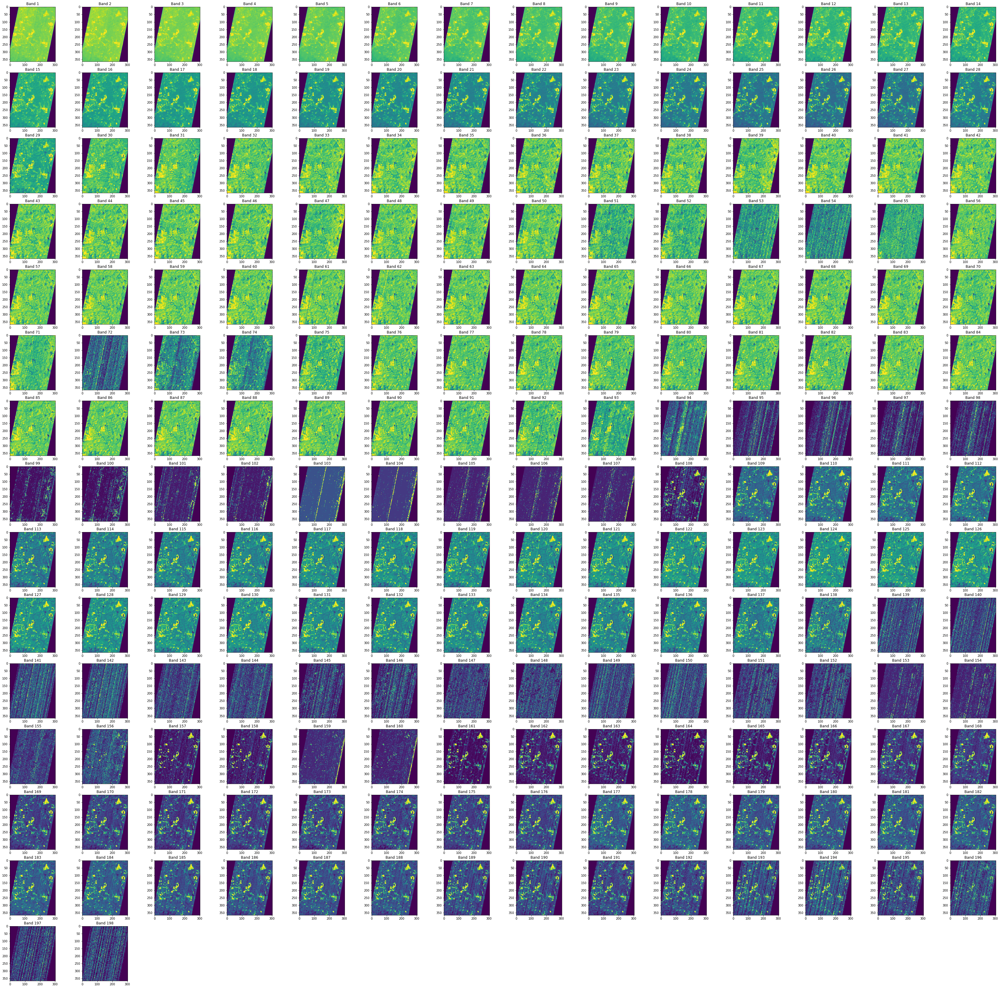

In [ ]:
from osgeo import gdal # We will use gdal to read the geoTiff Image
im = gdal.Open("/content/hyperion.tif") #  read image
im2d = im.ReadAsArray() # read the entire image as numpy array [bands x rows x cols]
im2d = im2d.transpose([1, 2 ,0]) # rearrange data into rows x cols x bands
num_bands = im2d.shape[2] # check the number of bands
plt.figure(figsize=(60,60)) # figure wise
plt.title("Hyperion Image")
for band in range(num_bands): # for each band in im2d
  plt.subplot(15,14, band +1)
  im_b = im2d[:, :, band].astype('float') # read each band as float
  p_2, p_98 = np.percentile(im_b.flatten(),[2, 98]) # find the upper and lower 2-percentiles  
  plt.imshow(im_b, vmin=p_2, vmax=p_98)
  plt.title(f"Band {band +1 }")

We also display the False Color Composite 

Text(0.5, 1.0, 'Band Red: 42, Green: 15 and Blue: 4')

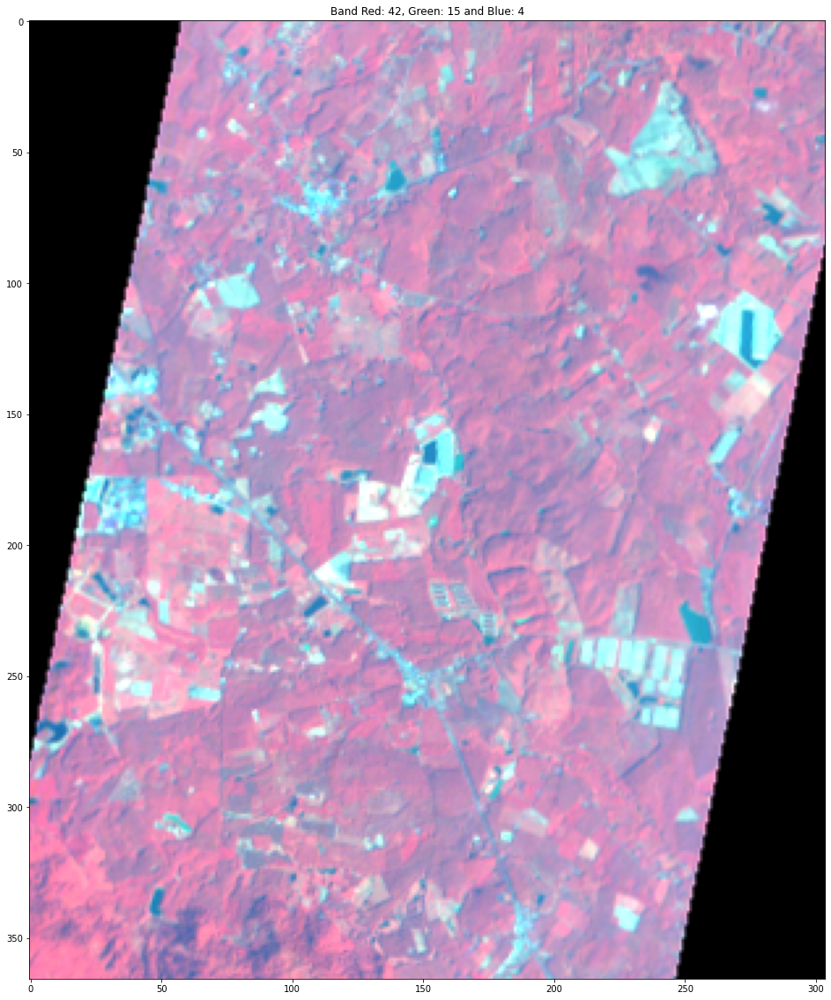

In [ ]:
display_im = im2d[:, :, [42, 15, 4]].astype('float32')
for band in range(3):
  p_2, p_98 = np.percentile(display_im[:, :, band].flatten(),[2, 98])
  display_im[:, :, band] = (display_im[:, :, band] - p_2)/(p_98 - p_2)
display_im[display_im<0] = 0
display_im[display_im>1] = 1
display_im[im2d[:, :, [42, 15, 4]]==0] = 0 
plt.figure(figsize=(20,20))
plt.imshow(display_im)
plt.title("Band Red: 42, Green: 15 and Blue: 4")

## PCA Example

In [ ]:
# pca example.
def transformImageFromCovMat(im1d:np.ndarray,  # 1-D image pixels x bands
                            cov_mat:np.ndarray, # bands x bands
                            zero_mean:bool = True
                            )->np.ndarray:
  eigval, eigvec = np.linalg.eigh(cov_mat) # compute eigenvalues and eigvectors
  idx = np.argsort(eigval)[::-1] # sort from largetst to smallest.
  d_vec = eigval[idx] # sort eigen value
  w_mat = eigvec[:, idx]  # sort eigen vector
  if zero_mean: # if we want to make zero-mean image
    mu = im1d.mean(0)  
    im1d = im1d - mu[np.newaxis, :]
  transed_im = np.dot(im1d, w_mat) # perform the transformation
  normzlized_im = transed_im / np.sqrt(d_vec[np.newaxis,:]) # normalized with sqrt{eigen values}
  return normzlized_im

def compPCA(im:np.array)->np.array:
  # This function is the main PCA
  nz_rows, nz_cols = np.nonzero(im[:,:,0]!=0) # find non-zeros pixels
  im1d = im[nz_rows, nz_cols, :] # we work on non-zero pixel only.
  covmat = np.cov(im1d, rowvar=False) # compute convariance matrix
  pca1d = transformImageFromCovMat(im1d, covmat, zero_mean=True) # perform the transformation based on the cov mat
  pca2d = np.zeros_like(im, dtype=np.float) # Initialize the output image
  pca2d[nz_rows, nz_cols, :] = pca1d # assign nonzero area with the PCA output
  return pca2d

We observe that there are many bands that appear to be noisy. This noisy pattern may the result of absorption in the atmosphere.

Next, we display each band of PCA

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


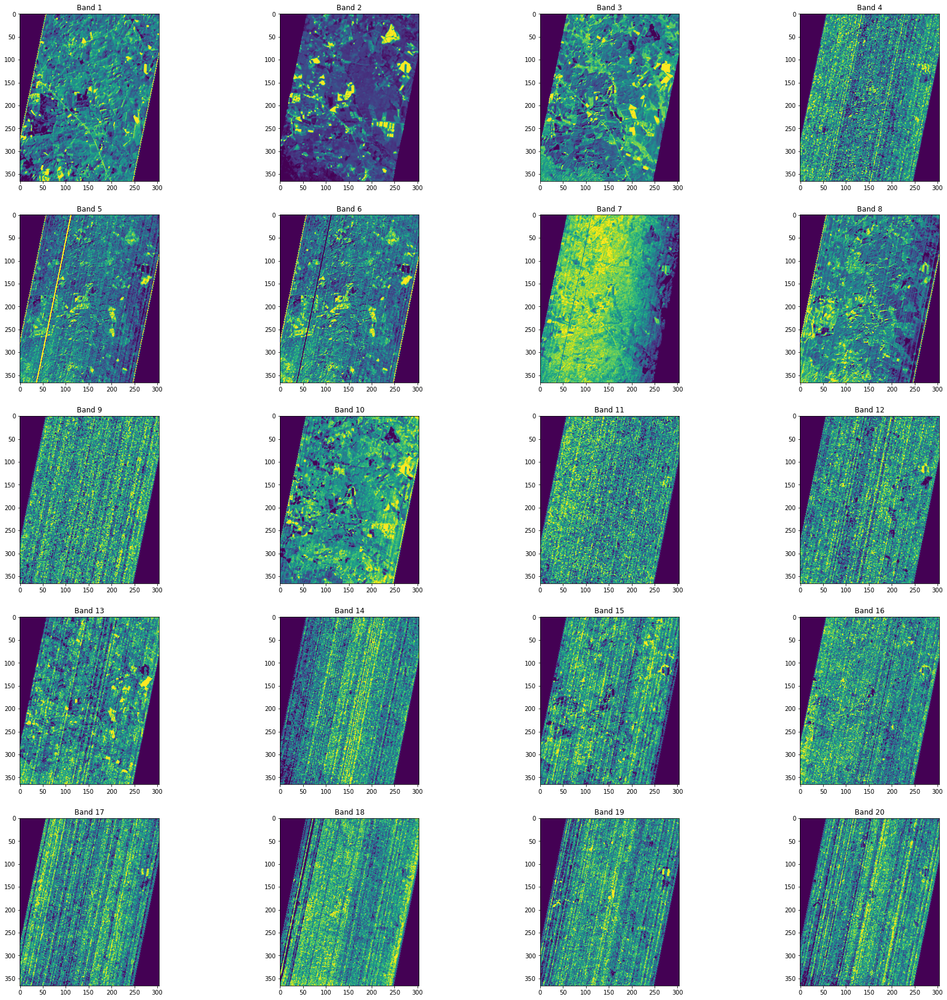

In [ ]:
pca_im = compPCA(im2d)
im_disp = np.zeros_like(pca_im)
plt.figure(figsize=(30,30))
for band in range(20):
  plt.subplot(5,4, band +1)
  im_b = pca_im[:, :, band].astype('float')
  p_2, p_98 = np.percentile(im_b.flatten(),[2, 98])
  im_b[pca_im[:, :, band]==0] = p_2 # kee no data region 0
  plt.imshow(im_b, vmin=p_2, vmax=p_98)
  plt.title(f"Band {band +1 }")

We observe that most of the variation are concentrated on the first 10 bands.
However, we diplay the RBG images using sequential components for the first 18 PCA components.

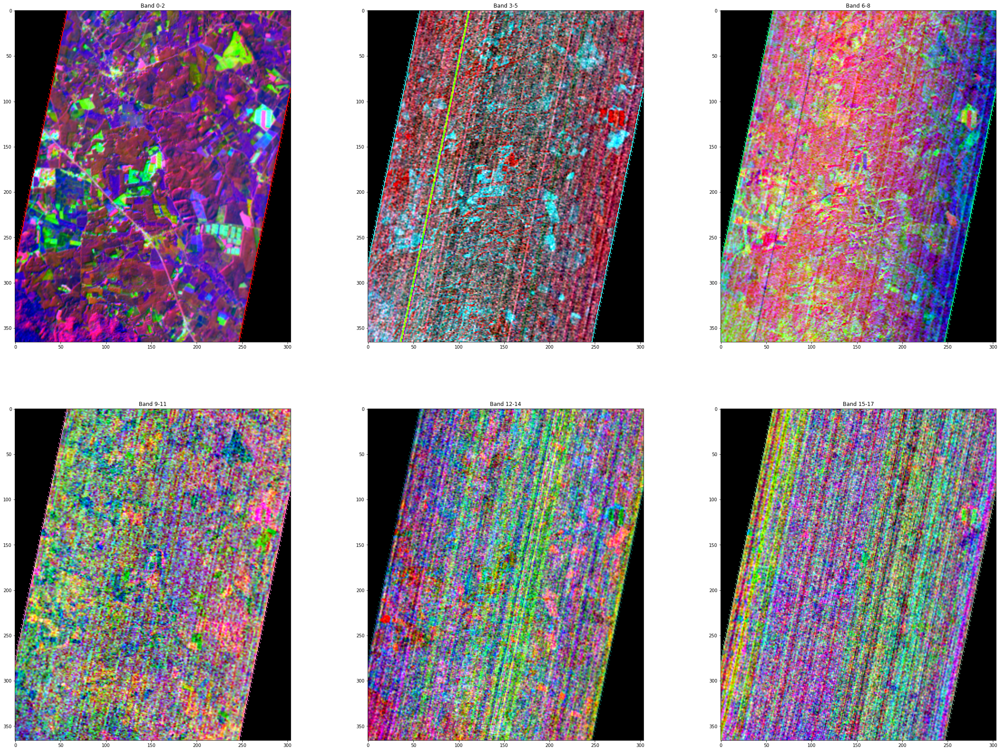

In [ ]:
n_rows, n_cols, _ = pca_im.shape
num_bands = 18
im_disp = np.zeros((n_rows, n_cols, num_bands), 'float32')
for band in range(num_bands):
  p_2, p_98 = np.percentile(pca_im[:, :, band].flatten(),[2, 98])
  im_disp[:, :, band] = (pca_im[:, :, band] - p_2)/(p_98 - p_2)
im_disp[im_disp<0] = 0
im_disp[im_disp>1] = 1
im_disp[pca_im[:,:,:num_bands]==0] = 0 
plt.figure(figsize=(40,30))
for k, b0 in enumerate(range(0, num_bands,3), start=1):
  plt.subplot(2,3,k)
  plt.imshow(im_disp[:, :, b0:(b0 + 3)]) 
  plt.title(f"Band {b0}-{b0+2}")

The example below is how to export PCA image into Geotiff Image where you can use QGIS to display them.

In [ ]:
def exportToGeoTiffImage(out_file_name, org_im_file_name, transformed_image):
  driver = gdal.GetDriverByName("GTiff")
  im_org = gdal.Open(org_im_file_name)
  n_rows, n_cols, n_bands = transformed_image.shape
  out_image = driver.Create(out_file_name, n_cols, n_rows, n_bands, gdal.GDT_Float32)
  for band in range(n_bands):
    im_band = out_image.GetRasterBand(band + 1)
    im_band.WriteArray(transformed_image[:, :, band].astype('float32'))
  out_image.SetGeoTransform(im_org.GetGeoTransform())
  out_image.SetProjection(im_org.GetProjection())
  out_image = None 
  

In [ ]:
exportToGeoTiffImage("/content/pca.tif", "/content/hyperion.tif", pca_im)

Let us compare the first 3 components with the google satellite image

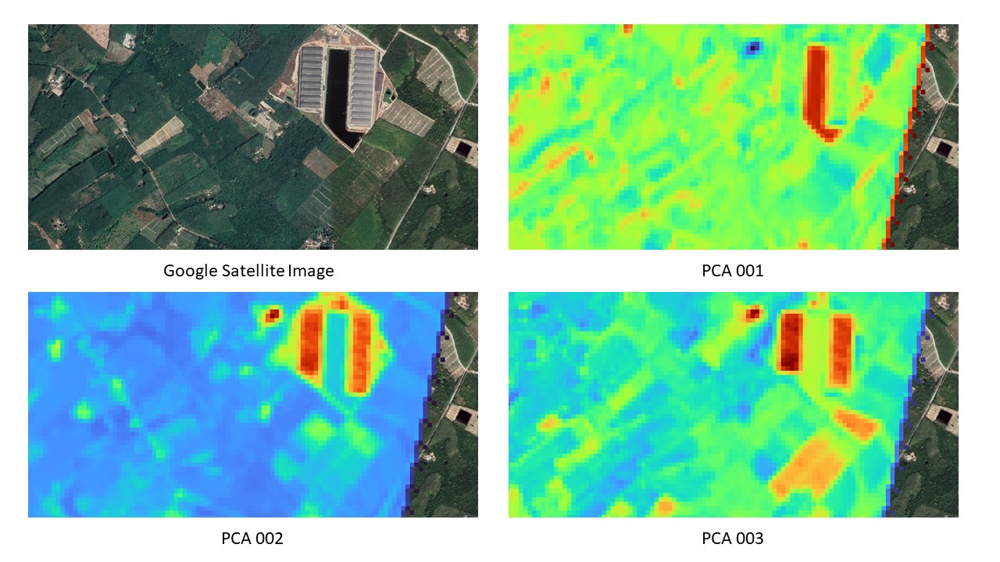

We observed that PCA001 appears to correspond to water whereas both PCA002 and PCA003 correspond with roof. However, PCA003 responds better with field on the lower right.

## Question 8:
Create your own code for computing the minimum noise fraction using neighboring pixels to compute the noise covariance matrix. The minimum noise fraction composes of two steps.

1. Compute noise convariance matrix
2. Whiten the image using image transformImageFromCovMat
3. Compute PCA on the whitened image.

In [ ]:
# your code here


## Question 9:

Display the first 20 components of MNF and compare it with PCA

In [ ]:
# Your code here


Answer 9:______________________.

## Question 10:
Display the sequential color composite similar to PCA example using the first 18 bands.

In [ ]:
# your code here


## Question 11:
Use sklearn.decomposition.FastICA to compute ICA of the *hyperion* image with 15 components

In [ ]:
# your code here


## Question 12:
Display the 15 ICA components

In [ ]:
# Your code here


Save ICA into a geotiff file and compare with Google satellite. To add Google Satellite into QGIS. Please follow this [instruction](https://socalgis.org/2019/11/06/add-google-maps-to-qgis-3/)

In [ ]:
exportToGeoTiffImage("/content/ica.tif", "/content/hyperion.tif", ica_im)

## Question 13:
Is there any link between ICA components and ground cover class? If yes, how. 

Answer 13:________________.